# Initial Check
Let's do a quick spot check to see what we are working with. Bring in a couple of images, and print them.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib.image as mpimg
import numpy as np
from PIL import Image
from scipy import sparse
from scipy import ndimage
from scipy.ndimage import gaussian_filter
from skimage import data
from skimage import img_as_float
from skimage import morphology, measure
from skimage.color import label2rgb

%matplotlib inline

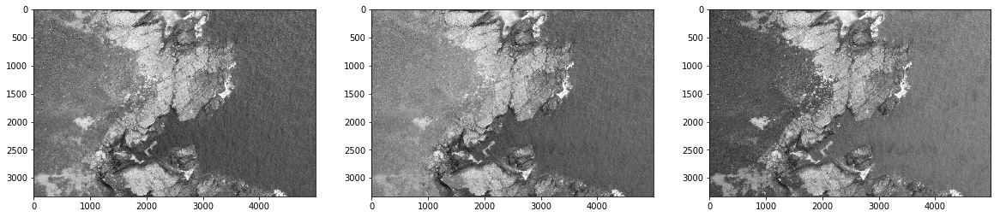

In [2]:
raw_image = mpimg.imread('../input/Train/3.jpg')
dot_image = mpimg.imread('../input/TrainDotted/3.jpg')

# Convert to floats. Will save us headache later.
raw_image = raw_image.astype(float)
dot_image = dot_image.astype(float)
raw_image = raw_image / raw_image.max()
dot_image = dot_image / dot_image.max()

# Spotcheck the data.
plt.figure(figsize=(20,20))
plt.subplot(1, 3, 1)
imgplot = plt.imshow(raw_image[:, :, 0], cmap=plt.cm.gray)
plt.subplot(1, 3, 2)
imgplot = plt.imshow(raw_image[:, :, 1], cmap=plt.cm.gray)
plt.subplot(1, 3, 3)
imgplot = plt.imshow(raw_image[:, :, 2], cmap=plt.cm.gray)
plt.show()

def img_to_float(m):
    m = m.astype(float)
    return m / m.max()

def float_to_img(m):
    return (m * 255.).astype(int)

def spot_check(img, show_pil=False):
    imgplot = plt.imshow(img)
    plt.show()

    if show_pil:
        # We can use this to see a higher resolution image, useful for checking things.
        pil_image = Image.fromarray((img*255.0).astype('uint8'))
        pil_image.show()

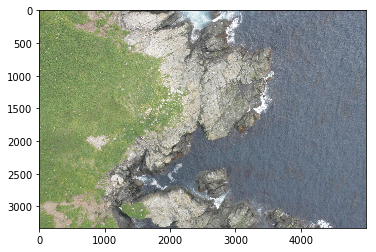

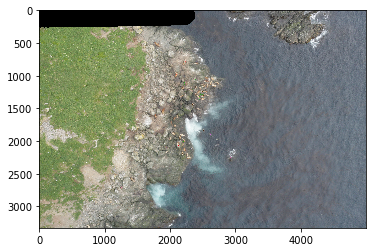

In [4]:
spot_check(raw_image, True)
spot_check(dot_image, True)

# General Thoughts

Since finding the sea lions in the image is a big part of the challenge. Let's dig in with a few segmentation routines and see how we do.

### Measuring success.

Before we get started let's look into being able to measure our success. Ideally we'd have a bounding box around each sea lion. A bounding box would allow us to perform other types of machine learning to predict sea lion type.

That sounds tricky! Let's attack a simpler problems. Getting the pixel underneath the labeled dot. In order to make it into a proper score we need actual metrics, let's look into the following.
1. Dots that have a label vs dots that don't.
2. Labels that match a dot vs labels that don't.

This roughly maps to some similar terms. A true positive rate (#1), and a false positive rate (#2). This will allow us to use a confusion matrix to compare. And possibly, as we mess with parameters an ROC curve to graph things out.

### Blobs
One caveat to consider. The above is over simplified for our problem. We need a way to simplify blobs down to the full sea lion and nothing else. We'll keep that in the back of our mind as we move forward and may want to collect some of these values together.

## Segmenting dots

First, let's segment the dots. This should be a simpler problem, we know the color names. 

### Bandpass
First thought, let's do a vary narrow bandpass filter on those colors and see how it turns out. First let's inspect the image in gimp and look at the dots.

The following are colors grabbed from the image:
brown = #572b06
green = #11b507
blue = #1941c7
red = #ff0701
magenta = #f806f0

Upon investigating the image we noticed a few things.

#### Good news.
The colors are pretty visually obvious. So it should be fairly easy to segment.

#### Bad news.
This was compressed as a jpeg, so there are obvious artifacts inside each color. The colors picked could possibly exist in the image (such as brown), so we may have to spend extra time ensuring we have a certain size. We even found one that was probably marked brown, but was hard to distinguish from his shadow.

A bandpass may not work with so much noise.

### Image difference

One big thing we have going for us is we have the original image. Our second thought is take a difference of the two images. This should leave us with nothing but the original dots. Let's give this a try.

### Initial Mask

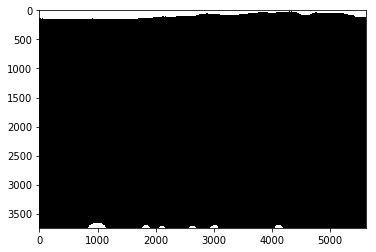

In [97]:
# Dot images have some black artifacts. Let's mask those out.
dot_norm = np.linalg.norm(dot_image, axis=2)
threshold = (dot_norm.max() - dot_norm.min()) * 0.005
initial_mask_1d = dot_norm <= threshold

for i in range(5):
    initial_mask_1d = ndimage.binary_dilation(initial_mask_1d)

# Broadcast to 3d for true image mask.
_, initial_mask = np.broadcast_arrays(dot_image, initial_mask_1d[..., None])

plt.imshow(initial_mask.astype(float))
plt.show()

### Remove background. Compare channels.

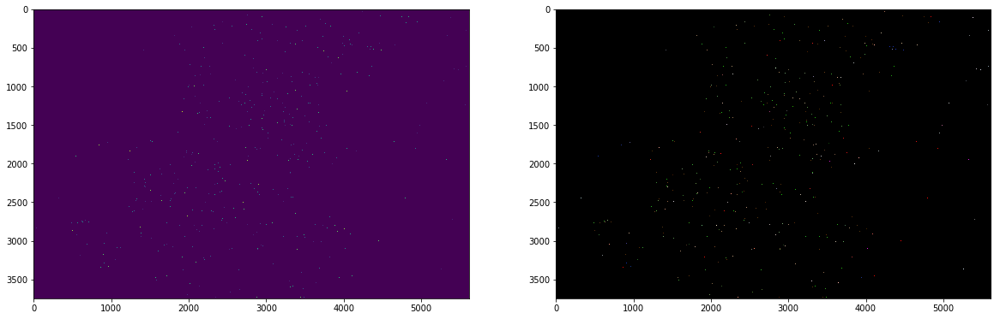

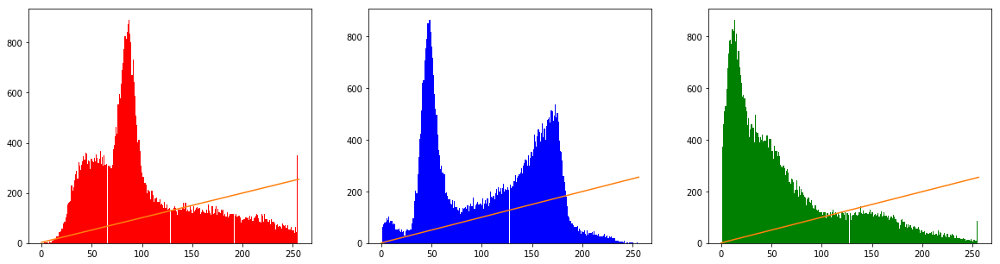

In [102]:
# Remove the background. Mask with the original image.
#dot_diff = np.abs(dot_image - raw_image)
dot_diff = np.linalg.norm(dot_image - raw_image, axis=2)
dot_diff[initial_mask[:, :, 0]] = 0

# Remove jpeg artifact noise.
dot_diff[dot_diff < 0.15] = 0

# Other ways to consider removing noise.
#dot_diff = ndimage.binary_opening(dot_diff)
#dot_diff = ndimage.binary_closing(dot_diff)

plt.figure(figsize=(20,20))
plt.subplot(1, 2, 1)
imgplot = plt.imshow(dot_diff)

def mask_image(m, mask, c):
    mask_1d = mask < 0.01
    _, mask_3d = np.broadcast_arrays(m, mask_1d[..., None])
    m[mask_3d] = c

dots = dot_image.copy()
mask_image(dots, dot_diff, 0)
plt.subplot(1, 2, 2)
imgplot = plt.imshow(dots)
plt.show()

def channel_histogram(m, idx, color):
    c = (m[:, :, idx] * 255).astype('uint8')
    c = c[c > 0]
    n, bins, patches = plt.hist(c.ravel(), bins=256, facecolor=color)
    plt.plot(bins)

def print_histograms(m):
    plt.figure(figsize=(20,5))
    plt.subplot(1, 3, 1)
    channel_histogram(m, 0, 'red')
    plt.subplot(1, 3, 2)
    channel_histogram(m, 1, 'blue')
    plt.subplot(1, 3, 3)
    channel_histogram(m, 2, 'green')
    plt.show()

print_histograms(dots)
#spot_check(dots, True)


We found some interesting things. First there's a significant amount of noise that we're dealing with (thanks jpeg). Second, by visually inspecting the images, we see that this approach could actually work really well.

Let's see if we can clean up the noise just a little bit by using some imaging techniques.

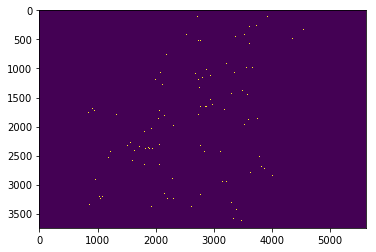

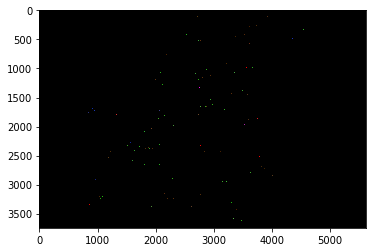

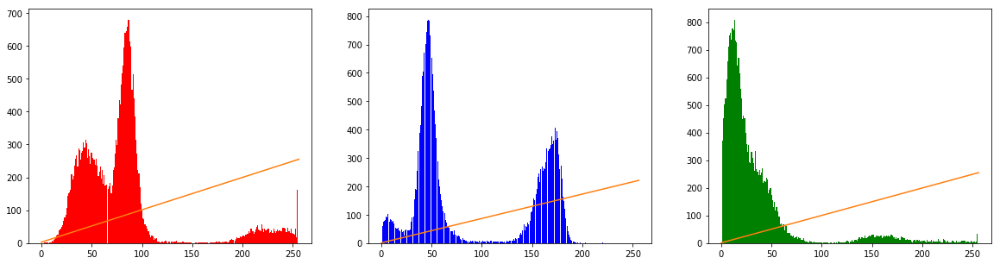

In [103]:
# Other ways to consider removing noise.
dot_diff_eroded = dot_diff > 0.01
dot_diff_eroded = morphology.closing(dot_diff_eroded)
dot_diff_eroded = ndimage.binary_erosion(dot_diff_eroded)
#dot_diff_eroded = ndimage.binary_erosion(dot_diff_eroded)
dots = dot_image.copy()
mask_image(dots, dot_diff_eroded, 0)

spot_check(dot_diff_eroded, False)
spot_check(dots, False)

print_histograms(dots)

That cleaned up our histograms significantly. We may have something to work with later. For now, let's ignore the different colors and focus on how accurate our detection is. We likely have missed some sea lion and will need to improve on this approach a little.

Let's start comparing our result to the counts we should have received. We're going to near 100% accuracy, otherwise out source data will be soiled.

Num of labels = 946


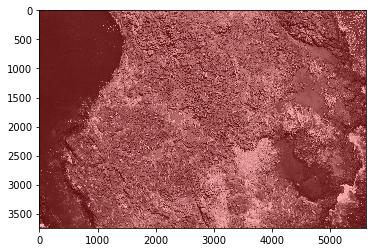

In [104]:
labeled_dots, label_count = morphology.label(dot_diff_eroded, return_num=True, connectivity=2)
rgb_labels = label2rgb(labeled_dots, raw_image)
imgplot = plt.imshow(rgb_labels)
print 'Num of labels = {}'.format(label_count)

946


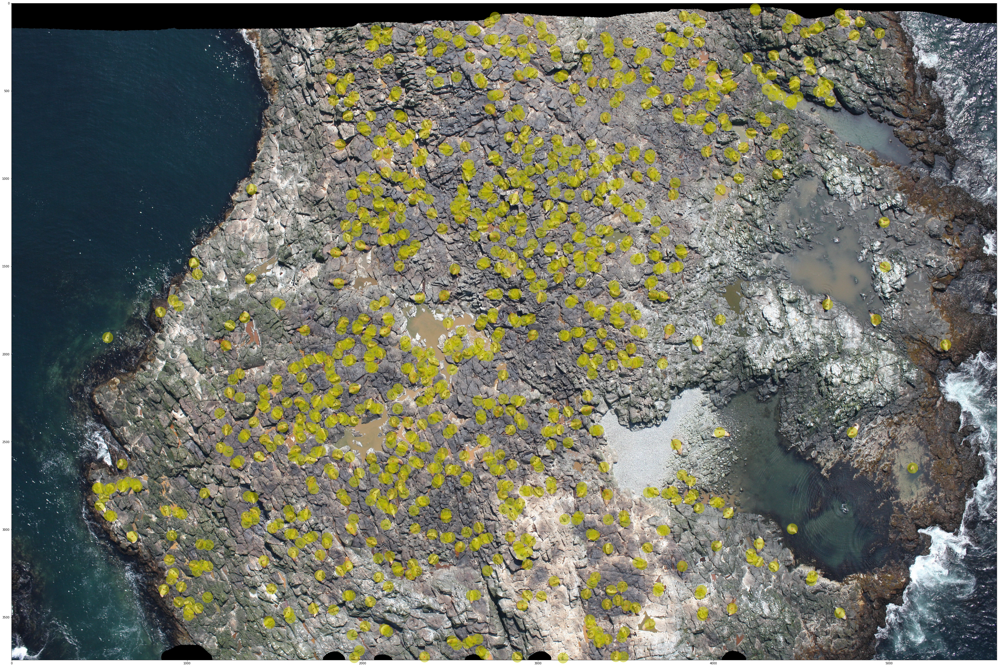

In [105]:
from skimage import measure
plt.figure(figsize=(60,60))
plt.imshow(dot_image)
axis = plt.gcf().gca()
props = measure.regionprops(labeled_dots)
print len(props)
for region in props:
    center = region.centroid
    c = plt.Circle((center[1], center[0]), 30, color='y', fill=True, clip_on=False, alpha=0.5)
    axis.add_artist(c)
plt.show()

## Counts
#### Pass 1 (1.jpg)
We've got a total of 39. The csv shows only 34. So we have 5 extra circles found. It is easy to see that our mistake is along the border. Something about how we are masking the edges causes us some greif. We'll have to look into how we can improve the edges. Let's go back and mess with our values.

#### Pass 2 (1.jpg)
By simply adding another erosion step we were able to get the correct count of 34 sea lions. I'm not sure this will extend to the other images. But for this image that means perfection. And a simple visual inspection implies that everything looks good as well.

#### Pass 3 (0.jpg)
With the second erode included the number found is much to low at only 767. Inspecting the image, we see we are missing all sorts of sea lions.

#### Pass 4 (0.jpg)
Removing the second erode increases the number to be much closer (932 of 946 found), but we now have issues at the boundaries again. We'll have to go back and review our previous steps to see if there is a better wait to ignore than boundaries than we are currently doing.

## Thoughts on finding sea lions
It seems like sea lions have a much more red hue than anything else (other than the muddy lakes often in the middle of the images. I wonder how much mileage we could make by simply subtracting one channel from another. 

#### Anisotraopic diffusion
Anothter problem we are going to run into is the natural variation in the sea lion color. Let's try to limit this by simply using an anisotropic_diffusion to make all the colors bleed a little without going over boundaries.

None of the libraries I'm familiar with have this built in be medpy seems to have a reasonable solution online, so let's use theirs.

In [313]:
def anisotropic_diffusion(img, niter=1, kappa=50, gamma=0.1, voxelspacing=None, option=1):
    import numpy
    r"""
    Edge-preserving, XD Anisotropic diffusion.


    Parameters
    ----------
    img : array_like
        Input image (will be cast to numpy.float).
    niter : integer
        Number of iterations.
    kappa : integer
        Conduction coefficient, e.g. 20-100. ``kappa`` controls conduction
        as a function of the gradient. If ``kappa`` is low small intensity
        gradients are able to block conduction and hence diffusion across
        steep edges. A large value reduces the influence of intensity gradients
        on conduction.
    gamma : float
        Controls the speed of diffusion. Pick a value :math:`<= .25` for stability.
    voxelspacing : tuple of floats
        The distance between adjacent pixels in all img.ndim directions
    option : {1, 2}
        Whether to use the Perona Malik diffusion equation No. 1 or No. 2.
        Equation 1 favours high contrast edges over low contrast ones, while
        equation 2 favours wide regions over smaller ones. See [1]_ for details.

    Returns
    -------
    anisotropic_diffusion : ndarray
        Diffused image.
        
    Notes
    -----
    Original MATLAB code by Peter Kovesi,
    School of Computer Science & Software Engineering,
    The University of Western Australia,
    pk @ csse uwa edu au,
    <http://www.csse.uwa.edu.au>

    Translated to Python and optimised by Alistair Muldal,
    Department of Pharmacology,
    University of Oxford,
    <alistair.muldal@pharm.ox.ac.uk>
    
    Adapted to arbitrary dimensionality and added to the MedPy library Oskar Maier,
    Institute for Medical Informatics,
    Universitaet Luebeck,
    <oskar.maier@googlemail.com>
    
    June 2000  original version. -
    March 2002 corrected diffusion eqn No 2. - 
    July 2012 translated to Python -
    August 2013 incorporated into MedPy, arbitrary dimensionality -    

    References
    ----------
    .. [1] P. Perona and J. Malik. 
       Scale-space and edge detection using ansotropic diffusion.
       IEEE Transactions on Pattern Analysis and Machine Intelligence, 
       12(7):629-639, July 1990.
    """
    # define conduction gradients functions
    if option == 1:
        def condgradient(delta, spacing):
            return numpy.exp(-(delta/kappa)**2.)/float(spacing)
    elif option == 2:
        def condgradient(delta, spacing):
            return 1./(1.+(delta/kappa)**2.)/float(spacing)

    # initialize output array
    out = numpy.array(img, dtype=numpy.float32, copy=True)
    
    # set default voxel spacong if not suppliec
    if None == voxelspacing:
        voxelspacing = tuple([1.] * img.ndim)

    # initialize some internal variables
    deltas = [numpy.zeros_like(out) for _ in xrange(out.ndim)]

    for _ in xrange(niter):

        # calculate the diffs
        for i in xrange(out.ndim):
            slicer = [slice(None, -1) if j == i else slice(None) for j in xrange(out.ndim)]
            deltas[i][slicer] = numpy.diff(out, axis=i)
        
        # update matrices
        matrices = [condgradient(delta, spacing) * delta for delta, spacing in zip(deltas, voxelspacing)]

        # subtract a copy that has been shifted ('Up/North/West' in 3D case) by one
        # pixel. Don't as questions. just do it. trust me.
        for i in xrange(out.ndim):
            slicer = [slice(1, None) if j == i else slice(None) for j in xrange(out.ndim)]
            matrices[i][slicer] = numpy.diff(matrices[i], axis=i)

        # update the image
        out += gamma * (numpy.sum(matrices, axis=0))

    return out

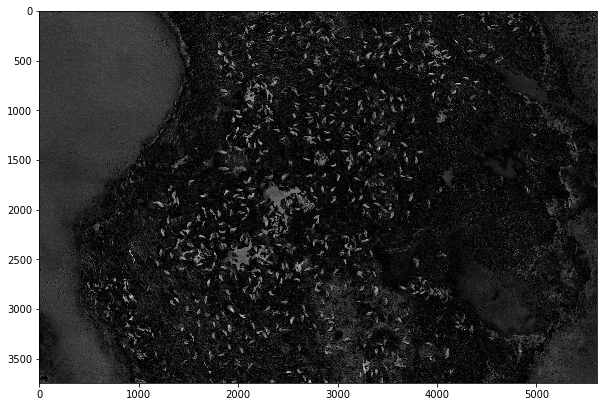

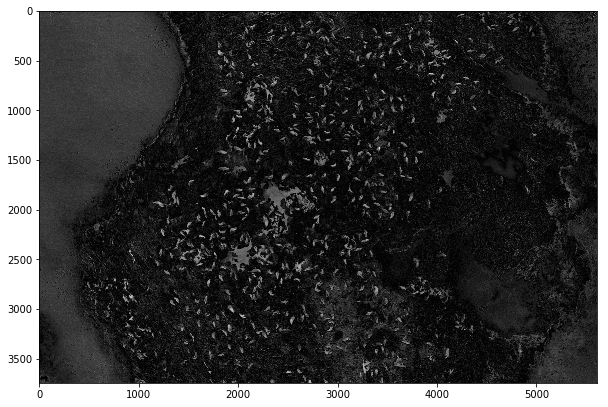

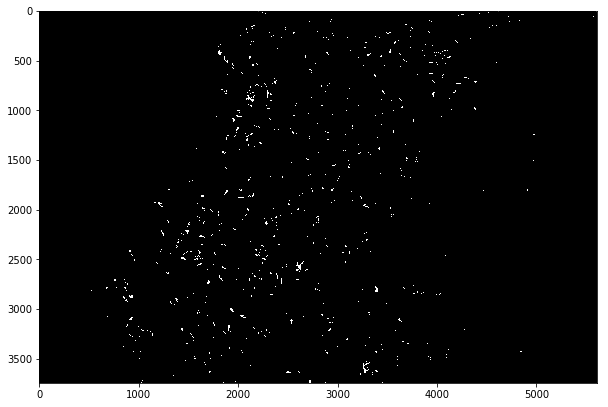

In [314]:
img = raw_image.astype(float)
dc = np.abs(img[:, :, 0] - img[:, :, 2])
aniso = anisotropic_diffusion(dc, 10, 200, .01)
#dc[dc < 0] = 0
mod = aniso
plt.figure(figsize=(10,10))
imgplot = plt.imshow(dc, cmap=plt.cm.gray)
plt.show()
plt.figure(figsize=(10,10))
imgplot = plt.imshow(aniso, cmap=plt.cm.gray)
plt.show()
plt.figure(figsize=(10,10))
imgplot = plt.imshow(aniso > .3, cmap=plt.cm.gray)
plt.show()

## Thoughts
On the first image this seemed like a reasonable approach. On this image we aren't getting nearly the same value out of such a simple calculation. I do think I'm going to go back to the first image and see if I can get some type of prediction. But for now I think I'll move on and start brainstorming more complex solutions.